Students (CSC713M) 


*   Gabriel Minamedez
*   Robin Reyes
*   Geosef Uy






# **Imports**

In [ ]:
%tensorflow_version 2.x
import numpy as np
import pathlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
from glob import glob
import PIL
import PIL.Image
import tensorflow as tf
from tensorflow.keras import datasets, layers, models

In [ ]:
!pip install keras_vggface
!pip install keras_applications
from keras_vggface.vggface import VGGFace

     |████████████████████████████████| 51kB 8.0MB/s 


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls '/content/drive/Shareddrives/CSC713M'

'3000 Face Mask Dataset'
'Annotated Project Proposal.pdf'
'CSC713M Final Project Notes.gdoc'
'CSC713M Manuscript.gdoc'
'CSC713M Project Proposal.docx'
'Different Masks Dataset'
 dropout01.h5
 face-mask-cnn.ipynb
'Final Project Presentation.gslides'
 flatten_afterbase15_dropout01_all_layers.h5
 flatten_afterbase20_dropout_all_layers.h5
 flatten_afterbase25_dropout_all_layers.h5
 flatten_dropout_05_and_03.h5
 flatten_dropout_1e-4_epoch10.h5
 flatten_dropout_1e-4_epoch15.h5
 flatten_dropout_1e-4_epoch20.h5
 flatten_dropout_1e-4_epoch25.h5
'Investigatory Project Checkpoint 1.gslides'
'Investigatory Project Checkpoint 2.gslides'
 maskclassification.tfrecords
'Model Experiment Results.gdoc'
'Saliency Maps'
 ThreeThousandFaceMaskDataset.zip


## Extracting Data Glob

In [ ]:
data = pathlib.Path('/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset') 
count = len(list(data.glob('*/*.png')))
count

3000

### Checking Sample No Mask Data

In [ ]:
no_mask = list(data.glob('3000 No Mask/*'))
# PIL.Image.open(str(no_mask[1]))

### Checking Sample Incorrect Mask Data

In [ ]:
correct_mask = list(data.glob('3000 Correct Mask/*'))
# PIL.Image.open(str(correct_mask[1]))

### Checking Sample Correct Mask Data

In [ ]:
incorrect_mask = list(data.glob('3000 Incorrect Mask/*'))
# PIL.Image.open(str(incorrect_mask[1]))

In [ ]:
print(len(no_mask), len(correct_mask), len(incorrect_mask))

3000 3000 3000


## Writing to TFRecords

In [ ]:
def _bytes_feature(value):
  if isinstance(value, type(tf.constant(0))):
    value = value.numpy()
  return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))
  
def _float_feature(value):
  return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))

def _int64_feature(value):
  return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

def image_example(image_string, label):

  feature = {
      'image_raw': _bytes_feature(image_string),
      'label': _int64_feature(label),
  }

  return tf.train.Example(features=tf.train.Features(feature=feature))

Images are scaled to 224x224 to fit VGG16 input layer and allow faster writing.

In [ ]:
filename = 'maskclassification.tfrecords'
with tf.io.TFRecordWriter(filename) as writer:
  for i in range(0, len(no_mask)):
    img = PIL.Image.open(no_mask[i])
    img = np.array(img.resize((224,224)))
    example = image_example(img.tobytes(), 0)
    writer.write(example.SerializeToString())
    print(i)
  for i in range(0, len(incorrect_mask)):
    img = PIL.Image.open(incorrect_mask[i])
    img = np.array(img.resize((224,224)))
    example = image_example(img.tobytes(), 1)
    writer.write(example.SerializeToString())
    print(i)
  for i in range(0, len(correct_mask)):
    img = PIL.Image.open(correct_mask[i])
    img = np.array(img.resize((224,224)))
    example = image_example(img.tobytes(), 2)
    writer.write(example.SerializeToString())
    print(i)


Streaming output truncated to the last 5000 lines.
1000
1001
1002
1003
1004
1005
1006
1007
1008
1009
1010
1011
1012
1013
1014
1015
1016
1017
1018
1019
1020
1021
1022
1023
1024
1025
1026
1027
1028
1029
1030
1031
1032
1033
1034
1035
1036
1037
1038
1039
1040
1041
1042
1043
1044
1045
1046
1047
1048
1049
1050
1051
1052
1053
1054
1055
1056
1057
1058
1059
1060
1061
1062
1063
1064
1065
1066
1067
1068
1069
1070
1071
1072
1073
1074
1075
1076
1077
1078
1079
1080
1081
1082
1083
1084
1085
1086
1087
1088
1089
1090
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
1181
1182
1183
1184
1185
1186
1187
1188
1189

## Reading from TFRecords

In [ ]:
full_dataset = tf.data.TFRecordDataset('/content/drive/Shareddrives/CSC713M/maskclassification.tfrecords')
image_feature_description = {
    'image_raw': tf.io.FixedLenFeature([], tf.string),
    'label': tf.io.FixedLenFeature([], tf.int64),
}
def _parse_image_function(example_proto):
  # Parse the input tf.train.Example proto using the dictionary above.
  return tf.io.parse_single_example(example_proto, image_feature_description)

parsed_image_dataset = full_dataset.map(_parse_image_function)
parsed_image_dataset

<MapDataset shapes: {image_raw: (), label: ()}, types: {image_raw: tf.string, label: tf.int64}>

In [ ]:
type(parsed_image_dataset)

tensorflow.python.data.ops.dataset_ops.MapDataset

In [ ]:
def format_image(record):
  img_list =[]
  label_list =[]
  for image_features in record:
    image_raw = image_features['image_raw'].numpy()
    image_raw = np.frombuffer(image_raw, dtype=np.uint8)
    label = image_features['label'] 
    img = image_raw.reshape(224, 224, 3)
    img_list.append(img)
    label_list.append(label)
  img_list = np.asarray(img_list)
  label_list = np.asarray(label_list)

  return img_list, label_list

# **Creating the Dataset**





In [ ]:
DATASET_SIZE = 9000
BUFFER_SIZE = 8000

train_size = int(0.8 * DATASET_SIZE)
test_size = int(0.2 * DATASET_SIZE)


full_dataset = full_dataset.shuffle(BUFFER_SIZE)
train_dataset = full_dataset.take(train_size)
test_dataset = full_dataset.skip(train_size)
test_dataset = test_dataset.take(test_size)

# **Building the Model Architecture**

## Initiating Pre-Trained Model for Base Layer

In [ ]:
# base_model = tf.keras.applications.VGG16(input_shape=(224,224,3),
#                                                include_top=False,
#                                                weights='imagenet')

58892288/58889256 [==============================] - 1s 0us/step


In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')

In [ ]:
base_model.summary()

Model: "vggface_vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 224, 224, 64)      1792      
_________________________________________________________________
conv1_2 (Conv2D)             (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
conv2_1 (Conv2D)             (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2_2 (Conv2D)             (None, 112, 112, 128)     147584    
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 56, 56, 128)     

## Freezing the Base Layer

In [ ]:
base_model.trainable = False

In [ ]:
base_model.summary()

Model: "vggface_vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 224, 224, 64)      1792      
_________________________________________________________________
conv1_2 (Conv2D)             (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
conv2_1 (Conv2D)             (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2_2 (Conv2D)             (None, 112, 112, 128)     147584    
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 56, 56, 128)     

## Adding the Other Layers

In [ ]:
# base_model.layers.pop(0)
# input_layer = tf.keras.Input(shape=(224, 224, 3))
# normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(scale=1./255)

In [ ]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

In [ ]:
prediction_layer = tf.keras.layers.Dense(3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')

In [ ]:
model = tf.keras.Sequential([
  # input_layer,
  # normalization_layer,
  base_model,
  global_average_layer,
  prediction_layer,
  softmax_layer
])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 3)                 1539      
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 12        
Total params: 14,716,239
Trainable params: 1,551
Non-trainable params: 14,714,688
_________________________________________________________________


# **Splitting the Data**

## Creating Train Dataset

In [ ]:
tr_dataset = train_dataset.map(_parse_image_function)
tr_img_list, tr_label_list = format_image(tr_dataset)

In [ ]:
tr_img_list.shape

(7200, 224, 224, 3)

In [ ]:
# tr_dataset= tf.data.Dataset.from_tensor_slices((tr_img_list, tr_label_list))

## Creating Validation Dataset (Skipped)

In [ ]:
# v_dataset = val_dataset.map(_parse_image_function)
# img_list, label_list = format_image(v_dataset)
# v_dataset= tf.data.Dataset.from_tensor_slices((img_list, label_list))

## Creating Test Dataset

In [ ]:
t_dataset = test_dataset.map(_parse_image_function)
t_img_list, t_label_list = format_image(t_dataset)

In [ ]:
t_img_list.shape

(1800, 224, 224, 3)

In [ ]:
# t_dataset= tf.data.Dataset.from_tensor_slices((t_img_list, t_label_list))

In [ ]:
# BATCH_SIZE = 50
# train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
# validation_batches = v_dataset.batch(BATCH_SIZE)

# **Training the Model**

## Training with Validation Set

In [ ]:
# BATCH_SIZE=50
# train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
# validation_batches = v_dataset.batch(BATCH_SIZE)

In [ ]:
# model.compile(optimizer='adam',
#                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
#                metrics=['accuracy'])
# history = model.fit(train_batches,
#                     epochs=3,
#                     validation_data=validation_batches)

# acc = history.history['accuracy']
# print(acc)

## K-Folds Cross Validation

In [ ]:
num_folds = 3
BATCH_SIZE = 50
index = int(tr_img_list.shape[0] / num_folds)
# saved_weights = model.get_weights()

### Test Case: Different Channels of Layers

In [ ]:
for i in [3, 5, 10, 15, 20, 30]:
  print("If prediction layer is ", i)
  base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
  base_model.trainable = False
  global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
  prediction_layer1 = tf.keras.layers.Dense(i * 10)
  prediction_layer2 = tf.keras.layers.Dense(i * 5)
  prediction_layer3 = tf.keras.layers.Dense(i * 3)
  prediction_layer4 = tf.keras.layers.Dense(i * 1)
  softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
  model = tf.keras.Sequential([
  # input_layer,
  # normalization_layer,
  base_model,
  global_average_layer,
  prediction_layer1,
  prediction_layer2,
  prediction_layer3,
  prediction_layer4,
  softmax_layer
  ])
  saved_weights = model.get_weights()
  for i in range(num_folds):
    print('Fold ', i+1)
    
    v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
    validation_batches = v_dataset.batch(BATCH_SIZE)

    tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
    if i + 1 != num_folds:
      tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
    train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
    
    model.set_weights(saved_weights)
    model.compile(optimizer='adam',
                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                metrics=['accuracy'])
    history = model.fit(train_batches,
                      epochs=3,
                      validation_data=validation_batches)
    
    acc = history.history['accuracy']
    print(acc)
    val_acc = history.history['val_accuracy']
    print(val_acc)


If prediction layer is  3
Fold  1
Epoch 1/3
96/96 [==============================] - 73s 362ms/step - loss: 2.2427 - accuracy: 0.6319 - val_loss: 0.3616 - val_accuracy: 0.8900
Epoch 2/3
96/96 [==============================] - 35s 361ms/step - loss: 0.2615 - accuracy: 0.9132 - val_loss: 0.3123 - val_accuracy: 0.8971
Epoch 3/3
96/96 [==============================] - 35s 364ms/step - loss: 0.1797 - accuracy: 0.9330 - val_loss: 0.1974 - val_accuracy: 0.9287
[0.7681249976158142, 0.9158333539962769, 0.9320833086967468]
[0.8899999856948853, 0.8970833420753479, 0.9287499785423279]
Fold  2
Epoch 1/3
96/96 [==============================] - 36s 366ms/step - loss: 2.8647 - accuracy: 0.5951 - val_loss: 0.3707 - val_accuracy: 0.8733
Epoch 2/3
96/96 [==============================] - 35s 363ms/step - loss: 0.3265 - accuracy: 0.8935 - val_loss: 0.2875 - val_accuracy: 0.9025
Epoch 3/3
96/96 [==============================] - 35s 365ms/step - loss: 0.1929 - accuracy: 0.9290 - val_loss: 0.2001 - val_a

### Test Case: Modified Number of Layers

In [ ]:
arr = [(1, 1), (2, 3), (3, 5), (4, 10)]
for i in range(4):
  base_model = VGGFace(input_shape=(224,224,3),
                        include_top=False,
                        model='vgg16',
                        weights='vggface')
  base_model.trainable = False
  global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
  model = tf.keras.Sequential([
  # input_layer,
  # normalization_layer,
  base_model,
  global_average_layer,
  ])
  for j in range(arr[i][0] - 1, -1, -1):
    model.add(tf.keras.layers.Dense(30 * arr[j][1]))
  softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
  model.add(softmax_layer)
  model.summary()
  saved_weights = model.get_weights()
  for i in range(num_folds):
    print('Fold ', i+1)
    
    v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
    validation_batches = v_dataset.batch(BATCH_SIZE)

    tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
    if i + 1 != num_folds:
      tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
    train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
    
    model.set_weights(saved_weights)
    model.compile(optimizer='adam',
                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                metrics=['accuracy'])
    history = model.fit(train_batches,
                      epochs=3,
                      validation_data=validation_batches)
    
    acc = history.history['accuracy']
    print(acc)
    val_acc = history.history['val_accuracy']
    print(val_acc)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_average_pooling2d_7 ( (None, 512)               0         
_________________________________________________________________
dense_35 (Dense)             (None, 30)                15390     
_________________________________________________________________
dense_36 (Dense)             (None, 3)                 93        
Total params: 14,730,171
Trainable params: 15,483
Non-trainable params: 14,714,688
_________________________________________________________________
Fold  1
Epoch 1/3
96/96 [==============================] - 35s 359ms/step - loss: 2.5779 - accuracy: 0.6336 - val_loss: 0.5465 - val_accuracy: 0.8696
Epoch 2/3
96/96 [==============================] - 35s 362ms/step - loss: 0.3475 - ac

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
prediction_layer1,
global_average_layer,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_61 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_60 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_59 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dense_58 (Dense)             (None, 7, 7, 30)          2730      
_________________________________________________________________
global_average_pooling2d_11  (None, 30)                0         
_________________________________________________________________
dense_62 (Dense)             (None, 3)               

### Test Case: Global Max Pooling

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
prediction_layer1,
global_max_layer,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_66 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_65 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_64 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dense_63 (Dense)             (None, 7, 7, 30)          2730      
_________________________________________________________________
global_max_pooling2d_2 (Glob (None, 30)                0         
_________________________________________________________________
dense_67 (Dense)             (None, 3)               

### Test Case: Max Pool Between 90 and 30

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_71 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_70 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_69 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_3 (Glob (None, 90)                0         
_________________________________________________________________
dense_68 (Dense)             (None, 30)                2730      
_________________________________________________________________
dense_72 (Dense)             (None, 3)               

### Test Case: Max Pool Between 150 and 90

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
global_max_layer,
prediction_layer2,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_76 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_75 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
global_max_pooling2d_4 (Glob (None, 150)               0         
_________________________________________________________________
dense_74 (Dense)             (None, 90)                13590     
_________________________________________________________________
dense_73 (Dense)             (None, 30)                2730      
_________________________________________________________________
dense_77 (Dense)             (None, 3)               

### Test Case: Max Pool Between 300 and 150

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
global_max_layer,
prediction_layer3,
prediction_layer2,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_81 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
global_max_pooling2d_5 (Glob (None, 300)               0         
_________________________________________________________________
dense_80 (Dense)             (None, 150)               45150     
_________________________________________________________________
dense_79 (Dense)             (None, 90)                13590     
_________________________________________________________________
dense_78 (Dense)             (None, 30)                2730      
_________________________________________________________________
dense_82 (Dense)             (None, 3)               

### Test Case: Max Pool Above 300

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
global_max_layer,
prediction_layer4,
prediction_layer3,
prediction_layer2,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=3,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_max_pooling2d_6 (Glob (None, 512)               0         
_________________________________________________________________
dense_86 (Dense)             (None, 300)               153900    
_________________________________________________________________
dense_85 (Dense)             (None, 150)               45150     
_________________________________________________________________
dense_84 (Dense)             (None, 90)                13590     
_________________________________________________________________
dense_83 (Dense)             (None, 30)                2730      
_________________________________________________________________
dense_87 (Dense)             (None, 3)               

### Test Case: LR=0.0001, Epoch=10

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_96 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_95 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_94 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_8 (Glob (None, 90)                0         
_________________________________________________________________
dense_93 (Dense)             (None, 30)                2730      
_________________________________________________________________
dense_97 (Dense)             (None, 3)               

### Test Case: Epoch=10

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_121 (Dense)            (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_120 (Dense)            (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_119 (Dense)            (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_13 (Glo (None, 90)                0         
_________________________________________________________________
dense_118 (Dense)            (None, 30)                2730      
_________________________________________________________________
dense_122 (Dense)            (None, 3)               

### Test Case: Dropout Layer Addition

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
dropout_layer = tf.keras.layers.Dropout(0.1)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
dropout_layer,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_8 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_7 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_6 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_1 (Glob (None, 90)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 30)                2730      
_________________________________________________________________
dropout_1 (Dropout)          (None, 30)               

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
dropout_layer = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
dropout_layer,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_8 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_7 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_6 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_1 (Glob (None, 90)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 30)                2730      
_________________________________________________________________
dropout_1 (Dropout)          (None, 30)               

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
dropout_layer = tf.keras.layers.Dropout(0.5)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
prediction_layer3,
prediction_layer2,
global_max_layer,
prediction_layer1,
dropout_layer,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_13 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dense_12 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_11 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d_2 (Glob (None, 90)                0         
_________________________________________________________________
dense_10 (Dense)             (None, 30)                2730      
_________________________________________________________________
dropout_2 (Dropout)          (None, 30)               

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
dropout_layer = tf.keras.layers.Dropout(0.1)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer,
prediction_layer3,
dropout_layer,
prediction_layer2,
dropout_layer,
global_max_layer,
prediction_layer1,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

58916864/58909280 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_3 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout (Dropout)            multiple                  0         
_________________________________________________________________
dense_2 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dense_1 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________________
global_max_pooling2d (Global (None, 90)                0         
_________________________________________________________

### Test Case: Remove Pooling and Add Flatten

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.5)
dropout_layer6 = tf.keras.layers.Dropout(0.5)
dropout_layer7 = tf.keras.layers.Dropout(0.5)
dropout_layer8 = tf.keras.layers.Dropout(0.5)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_107 (Dense)            (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_57 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_106 (Dense)            (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_58 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_105 (Dense)            (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_59 (Dropout)         (None, 7, 7, 90)        

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

58916864/58909280 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_3 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout (Dropout)            (None, 7, 7, 300)         0         
_________________________________________________________________
dense_2 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 150)         0         
_________________________________________________________________
dense_1 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.1)
dropout_layer6 = tf.keras.layers.Dropout(0.1)
dropout_layer7 = tf.keras.layers.Dropout(0.1)
dropout_layer8 = tf.keras.layers.Dropout(0.1)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_71 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_25 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_70 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_26 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_69 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_27 (Dropout)         (None, 7, 7, 90)        

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.3)
dropout_layer2 = tf.keras.layers.Dropout(0.3)
dropout_layer3 = tf.keras.layers.Dropout(0.3)
dropout_layer4 = tf.keras.layers.Dropout(0.3)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

58916864/58909280 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_3 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout (Dropout)            (None, 7, 7, 300)         0         
_________________________________________________________________
dense_2 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 150)         0         
_________________________________________________________________
dense_1 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.3)
dropout_layer2 = tf.keras.layers.Dropout(0.3)
dropout_layer3 = tf.keras.layers.Dropout(0.3)
dropout_layer4 = tf.keras.layers.Dropout(0.3)
dropout_layer5 = tf.keras.layers.Dropout(0.1)
dropout_layer6 = tf.keras.layers.Dropout(0.1)
dropout_layer7 = tf.keras.layers.Dropout(0.1)
dropout_layer8 = tf.keras.layers.Dropout(0.1)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_80 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_33 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_79 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_34 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_78 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_35 (Dropout)         (None, 7, 7, 90)        

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.1)
dropout_layer2 = tf.keras.layers.Dropout(0.1)
dropout_layer3 = tf.keras.layers.Dropout(0.1)
dropout_layer4 = tf.keras.layers.Dropout(0.1)
dropout_layer5 = tf.keras.layers.Dropout(0.1)
dropout_layer6 = tf.keras.layers.Dropout(0.1)
dropout_layer7 = tf.keras.layers.Dropout(0.1)
dropout_layer8 = tf.keras.layers.Dropout(0.1)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_12 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_8 (Dropout)          (None, 7, 7, 300)         0         
_________________________________________________________________
dense_11 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_9 (Dropout)          (None, 7, 7, 150)         0         
_________________________________________________________________
dense_10 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_10 (Dropout)         (None, 7, 7, 90)         

### Test Case: Flatten after base model 10 epochs

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
flatten_layer,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

58916864/58909280 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 300)               7526700   
_________________________________________________________________
dropout (Dropout)            (None, 300)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 150)               45150     
_________________________________________________________________
dropout_1 (Dropout)          (None, 150)               0         
_________________________________________________________

### Test Case: Flatten after base model 15 epochs



In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
flatten_layer,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=15,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_12 (Dense)             (None, 300)               7526700   
_________________________________________________________________
dropout_8 (Dropout)          (None, 300)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 150)               45150     
_________________________________________________________________
dropout_9 (Dropout)          (None, 150)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 90)               

### Test Case: Flatten after base model 20 epochs

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
flatten_layer,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=20,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_21 (Dense)             (None, 300)               7526700   
_________________________________________________________________
dropout_16 (Dropout)         (None, 300)               0         
_________________________________________________________________
dense_20 (Dense)             (None, 150)               45150     
_________________________________________________________________
dropout_17 (Dropout)         (None, 150)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 90)               

In [ ]:
model.save('flatten_afterbase20_dropout_all_layers.h5')

### Test Case: Flatten after base layer 25 epochs

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
flatten_layer,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=25,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_3 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_30 (Dense)             (None, 300)               7526700   
_________________________________________________________________
dropout_24 (Dropout)         (None, 300)               0         
_________________________________________________________________
dense_29 (Dense)             (None, 150)               45150     
_________________________________________________________________
dropout_25 (Dropout)         (None, 150)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 90)               

In [ ]:
model.save('flatten_afterbase25_dropout_all_layers.h5')

### Test Case: Flatten between dense layers (25 epochs) Dropout 0.5 and 0.3 (alpha = 1e-4)

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=25,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_12 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_8 (Dropout)          (None, 7, 7, 300)         0         
_________________________________________________________________
dense_11 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_9 (Dropout)          (None, 7, 7, 150)         0         
_________________________________________________________________
dense_10 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_10 (Dropout)         (None, 7, 7, 90)         

In [ ]:
model.save('flatten_dropout_1e-4_epoch25.h5')

### Test Case: Flatten between dense layers (20 epochs) Dropout 0.5 and 0.3 (alpha = 1e-4)

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=20,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_21 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_16 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_20 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_17 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_19 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_18 (Dropout)         (None, 7, 7, 90)         

In [ ]:
model.save('flatten_dropout_1e-4_epoch20.h5')

### Test Case: Flatten between dense layers (15 epochs) Dropout 0.5 and 0.3 (alpha = 1e-4)

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=15,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_30 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_24 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_29 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_25 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_28 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_26 (Dropout)         (None, 7, 7, 90)         

In [ ]:
model.save('flatten_dropout_1e-4_epoch15.h5')

### Test Case: Flatten between dense layers (10 epochs) Dropout 0.5 and 0.3 (alpha = 1e-4)

In [ ]:
base_model = VGGFace(input_shape=(224,224,3),
                      include_top=False,
                      model='vgg16',
                      weights='vggface')
base_model.trainable = False
flatten_layer = tf.keras.layers.Flatten()
prediction_layer1 = tf.keras.layers.Dense(30 * 1)
prediction_layer2 = tf.keras.layers.Dense(30 * 3)
prediction_layer3 = tf.keras.layers.Dense(30 * 5)
prediction_layer4 = tf.keras.layers.Dense(30 * 10)
prediction_layer5 = tf.keras.layers.Dense(30 * 10)
prediction_layer6 = tf.keras.layers.Dense(30 * 5)
prediction_layer7 = tf.keras.layers.Dense(30 * 3)
prediction_layer8 = tf.keras.layers.Dense(30 * 1)
dropout_layer1 = tf.keras.layers.Dropout(0.5)
dropout_layer2 = tf.keras.layers.Dropout(0.5)
dropout_layer3 = tf.keras.layers.Dropout(0.5)
dropout_layer4 = tf.keras.layers.Dropout(0.5)
dropout_layer5 = tf.keras.layers.Dropout(0.3)
dropout_layer6 = tf.keras.layers.Dropout(0.3)
dropout_layer7 = tf.keras.layers.Dropout(0.3)
dropout_layer8 = tf.keras.layers.Dropout(0.3)
softmax_layer = tf.keras.layers.Dense(3, activation='softmax')
model = tf.keras.Sequential([
# input_layer,
# normalization_layer,
base_model,
prediction_layer4,
dropout_layer1,
prediction_layer3,
dropout_layer2,
prediction_layer2,
dropout_layer3,
prediction_layer1,
dropout_layer4,
flatten_layer,
prediction_layer5,
dropout_layer5,
prediction_layer6,
dropout_layer6,
prediction_layer7,
dropout_layer7,
prediction_layer8,
dropout_layer8,
softmax_layer
])
model.summary()
saved_weights = model.get_weights()
for i in range(num_folds):
  print('Fold ', i+1)
  
  v_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i): index * (i+1)], tr_label_list[index * (i): index * (i+1)]))
  validation_batches = v_dataset.batch(BATCH_SIZE)

  tr_dataset = tf.data.Dataset.from_tensor_slices((tr_img_list[0 : index * (i)], tr_label_list[0 : index * (i)]))
  if i + 1 != num_folds:
    tr_dataset = tr_dataset.concatenate(tf.data.Dataset.from_tensor_slices((tr_img_list[index * (i+1): index * (num_folds)], tr_label_list[index * (i+1): index * (num_folds)])))
  train_batches = tr_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
  
  model.set_weights(saved_weights)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  history = model.fit(train_batches,
                    epochs=10,
                    validation_data=validation_batches)
  
  acc = history.history['accuracy']
  print(acc)
  acc = history.history['val_accuracy']
  print(acc)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_39 (Dense)             (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout_32 (Dropout)         (None, 7, 7, 300)         0         
_________________________________________________________________
dense_38 (Dense)             (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_33 (Dropout)         (None, 7, 7, 150)         0         
_________________________________________________________________
dense_37 (Dense)             (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_34 (Dropout)         (None, 7, 7, 90)         

In [ ]:
model.save('flatten_dropout_1e-4_epoch10.h5')

# **Discussion**

references:

https://github.com/sicara/tf-explain

https://tf-explain.readthedocs.io/en/latest/methods.html#grad-cam

https://github.com/TannerGilbert/Model-Interpretation/blob/master/TFExplain/callback_api_example.ipynb



## Confusion Matrix

In [ ]:
model = tf.keras.models.load_model('/content/drive/Shareddrives/CSC713M/flatten_dropout_05_and_03.h5')
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vggface_vgg16 (Functional)   (None, 7, 7, 512)         14714688  
_________________________________________________________________
dense_3 (Dense)              (None, 7, 7, 300)         153900    
_________________________________________________________________
dropout (Dropout)            (None, 7, 7, 300)         0         
_________________________________________________________________
dense_2 (Dense)              (None, 7, 7, 150)         45150     
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 150)         0         
_________________________________________________________________
dense_1 (Dense)              (None, 7, 7, 90)          13590     
_________________________________________________________________
dropout_2 (Dropout)          (None, 7, 7, 90)          0

In [ ]:
y_label = tr_label_list[5400:]
tr_img_list1 = tr_img_list[5400:]
y_pred = np.argmax(model.predict(tr_img_list1), axis=-1)
print(y_label)
print(y_pred)
print('The validation accuracy is:  {} %'.format(np.mean((y_pred == y_label)) * 100))
confusion_matrix = tf.math.confusion_matrix(y_label, y_pred)
confusion_matrix = confusion_matrix.numpy()

[1 1 0 ... 2 1 1]
[1 1 0 ... 2 1 1]
The validation accuracy is:  99.16666666666667 %


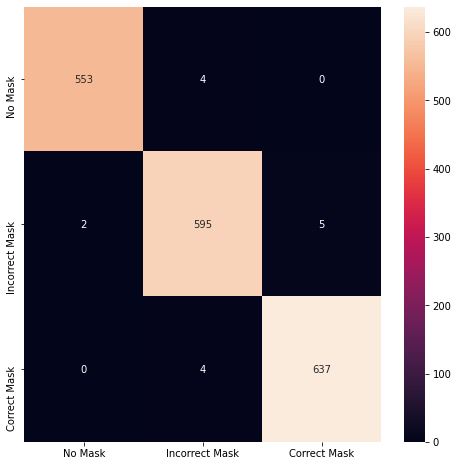

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

df = pd.DataFrame(confusion_matrix, index=['No Mask', 'Incorrect Mask', 'Correct Mask'], columns=['No Mask', 'Incorrect Mask', 'Correct Mask'])
plt.figure(figsize = (8,8))
sn.heatmap(df, annot=True, fmt = "d")

In [ ]:
a0_p0 = [i for i, x in enumerate(y_label) if x == 0 and y_pred[i] == 0]

In [ ]:
a0_p1 = [i for i, x in enumerate(y_label) if x == 0 and y_pred[i] == 1]

In [ ]:
a0_p2 = [i for i, x in enumerate(y_label) if x == 0 and y_pred[i] == 2]

In [ ]:
a1_p0 = [i for i, x in enumerate(y_label) if x == 1 and y_pred[i] == 0]

In [ ]:
a1_p1 = [i for i, x in enumerate(y_label) if x == 1 and y_pred[i] == 1]

In [ ]:
a1_p2 = [i for i, x in enumerate(y_label) if x == 1 and y_pred[i] == 2]

In [ ]:
a2_p0 = [i for i, x in enumerate(y_label) if x == 2 and y_pred[i] == 0]

In [ ]:
a2_p1 = [i for i, x in enumerate(y_label) if x == 2 and y_pred[i] == 1]

In [ ]:
a2_p2 = [i for i, x in enumerate(y_label) if x == 2 and y_pred[i] == 2]

## Saliency Map

In [ ]:
!pip install tf-explain
!pip install opencv-python

     |████████████████████████████████| 51kB 6.8MB/s 


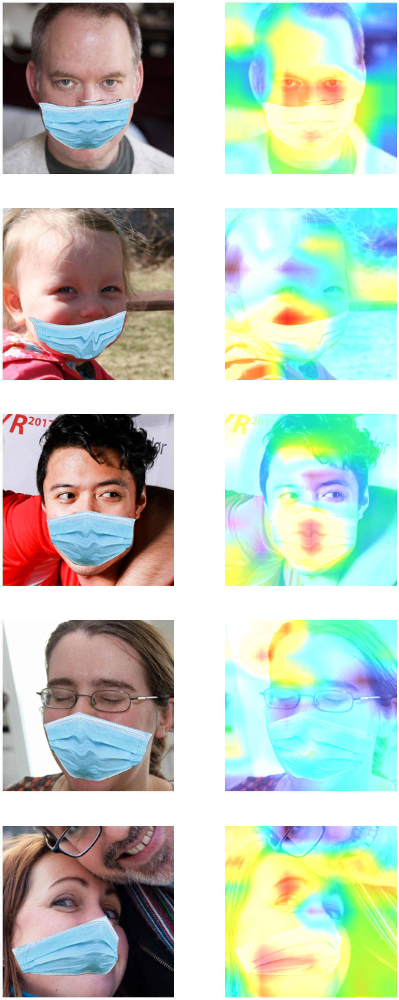

In [ ]:
from tf_explain.callbacks.grad_cam import GradCAM
import cv2

# IMAGE_PATH = '/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset/3000 Incorrect Mask/07000_Mask_Mouth_Chin.jpg'

# image = tf.keras.preprocessing.image.load_img(IMAGE_PATH, target_size=(224, 224))
# img = tf.keras.preprocessing.image.img_to_array(image)
fig, ax = plt.subplots(5, 2, figsize=(20, 5*10))
for i in range(5):

  img = tr_img_list1[a1_p2[i]]
  img_copy = tr_img_list1[a1_p2[i]]
  imax = img.max()
  imin = img.min()
  if imax != imin:
      img = (img - imin) / float(imax - imin)
  else:
      img = img - imin
  data = ([img], None)

  idx = 1
  explainer = GradCAM()
  grid = explainer.explain(data, model, idx, colormap=cv2.COLORMAP_TURBO)

  explainer.save(grid, '.', 'sample.png')

  ax[i][0].imshow(img_copy)
  ax[i][0].axis('off')
  ax[i][1].imshow(grid, cmap='gray', vmin=0, vmax=255)
  ax[i][1].axis('off')
plt.show()

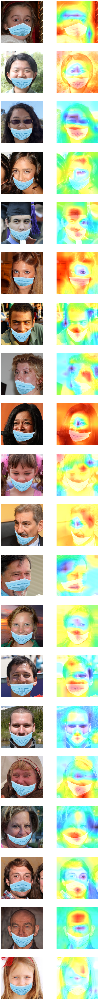

In [ ]:
from tf_explain.callbacks.grad_cam import GradCAM
import cv2

# IMAGE_PATH = '/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset/3000 Incorrect Mask/07000_Mask_Mouth_Chin.jpg'

# image = tf.keras.preprocessing.image.load_img(IMAGE_PATH, target_size=(224, 224))
# img = tf.keras.preprocessing.image.img_to_array(image)
fig, ax = plt.subplots(20, 2, figsize=(20, 20*10))
for i in range(20):

  img = tr_img_list1[a1_p1[i]]
  img_copy = tr_img_list1[a1_p1[i]]
  imax = img.max()
  imin = img.min()
  if imax != imin:
      img = (img - imin) / float(imax - imin)
  else:
      img = img - imin
  data = ([img], None)

  idx = 1
  explainer = GradCAM()
  grid = explainer.explain(data, model, idx, colormap=cv2.COLORMAP_TURBO)

  explainer.save(grid, '.', 'sample.png')

  ax[i][0].imshow(img_copy)
  ax[i][0].axis('off')
  ax[i][1].imshow(grid, cmap='gray', vmin=0, vmax=255)
  ax[i][1].axis('off')
plt.show()

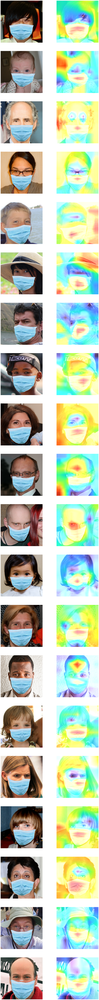

In [ ]:
from tf_explain.callbacks.grad_cam import GradCAM
import cv2

# IMAGE_PATH = '/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset/3000 Incorrect Mask/07000_Mask_Mouth_Chin.jpg'

# image = tf.keras.preprocessing.image.load_img(IMAGE_PATH, target_size=(224, 224))
# img = tf.keras.preprocessing.image.img_to_array(image)
fig, ax = plt.subplots(20, 2, figsize=(20, 20*10))
for i in range(20):

  img = tr_img_list1[a2_p2[i]]
  img_copy = tr_img_list1[a2_p2[i]]
  imax = img.max()
  imin = img.min()
  if imax != imin:
      img = (img - imin) / float(imax - imin)
  else:
      img = img - imin
  data = ([img], None)

  idx = 1
  explainer = GradCAM()
  grid = explainer.explain(data, model, idx, colormap=cv2.COLORMAP_TURBO)

  explainer.save(grid, '.', 'sample.png')

  ax[i][0].imshow(img_copy)
  ax[i][0].axis('off')
  ax[i][1].imshow(grid, cmap='gray', vmin=0, vmax=255)
  ax[i][1].axis('off')
plt.show()

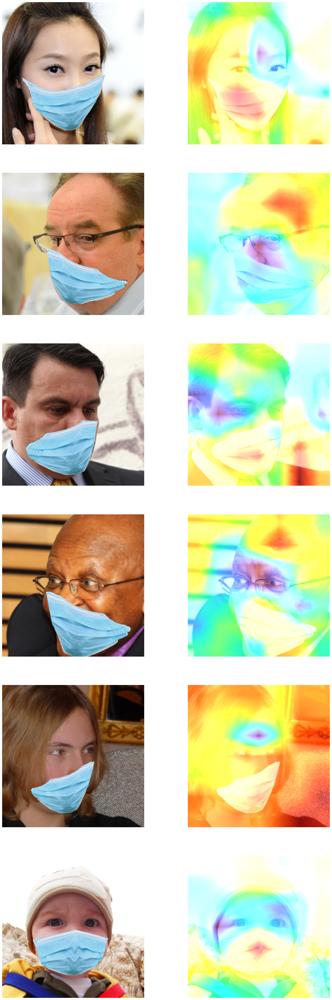

In [ ]:
from tf_explain.callbacks.grad_cam import GradCAM
import cv2

# IMAGE_PATH = '/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset/3000 Incorrect Mask/07000_Mask_Mouth_Chin.jpg'

# image = tf.keras.preprocessing.image.load_img(IMAGE_PATH, target_size=(224, 224))
# img = tf.keras.preprocessing.image.img_to_array(image)
fig, ax = plt.subplots(len(a2_p1), 2, figsize=(20, len(a2_p1)*10))
for i in range(len(a2_p1)):

  img = tr_img_list1[a2_p1[i]]
  img_copy = tr_img_list1[a2_p1[i]]
  imax = img.max()
  imin = img.min()
  if imax != imin:
      img = (img - imin) / float(imax - imin)
  else:
      img = img - imin
  data = ([img], None)

  idx = 1
  explainer = GradCAM()
  grid = explainer.explain(data, model, idx, colormap=cv2.COLORMAP_TURBO)

  explainer.save(grid, '.', 'sample.png')

  ax[i][0].imshow(img_copy)
  ax[i][0].axis('off')
  ax[i][1].imshow(grid, cmap='gray', vmin=0, vmax=255)
  ax[i][1].axis('off')
plt.show()

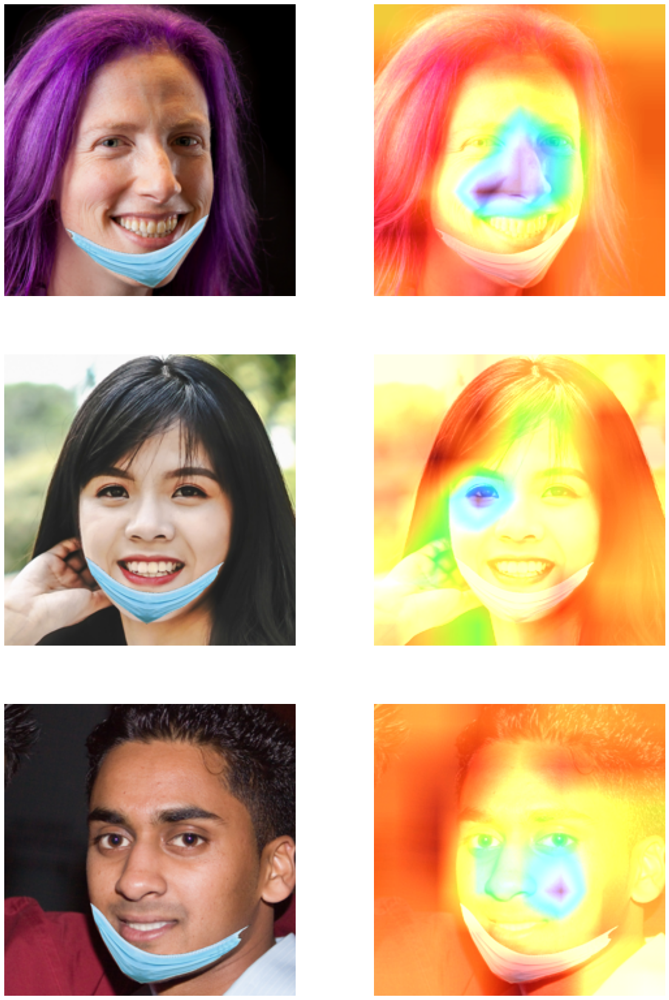

In [ ]:
from tf_explain.callbacks.grad_cam import GradCAM
import cv2

# IMAGE_PATH = '/content/drive/Shareddrives/CSC713M/3000 Face Mask Dataset/3000 Incorrect Mask/07000_Mask_Mouth_Chin.jpg'

# image = tf.keras.preprocessing.image.load_img(IMAGE_PATH, target_size=(224, 224))
# img = tf.keras.preprocessing.image.img_to_array(image)
fig, ax = plt.subplots(len(a1_p0), 2, figsize=(20, len(a1_p0)*10))
for i in range(len(a1_p0)):

  img = tr_img_list1[a1_p0[i]]
  img_copy = tr_img_list1[a1_p0[i]]
  imax = img.max()
  imin = img.min()
  if imax != imin:
      img = (img - imin) / float(imax - imin)
  else:
      img = img - imin
  data = ([img], None)

  idx = 1
  explainer = GradCAM()
  grid = explainer.explain(data, model, idx, colormap=cv2.COLORMAP_TURBO)

  explainer.save(grid, '.', 'sample.png')

  ax[i][0].imshow(img_copy)
  ax[i][0].axis('off')
  ax[i][1].imshow(grid, cmap='gray', vmin=0, vmax=255)
  ax[i][1].axis('off')
plt.show()

# **Testing the Model**

In [ ]:
y_pred = np.argmax(model.predict(t_img_list), axis=-1)

In [ ]:
y_pred.shape

(1800,)

In [ ]:
print('The test accuracy is:  {} %'.format(np.mean((y_pred == t_label_list)) * 100))

The test accuracy is:  99.11111111111111 %


In [ ]:
confusion_matrix = tf.math.confusion_matrix(t_label_list, y_pred)
confusion_matrix = confusion_matrix.numpy()
print(confusion_matrix)
FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix)  
print(FP)
TP = np.diag(confusion_matrix)
print(TP)
FDR = FP/(TP+FP)
print(FDR)

[[597   4   0]
 [  4 598   4]
 [  0   4 589]]
[4 8 4]
[597 598 589]
[0.00665557 0.01320132 0.00674536]


In [ ]:
model.save('facemaskdetection.h5')

# Testing on Different Mask Types

In [ ]:
image_list = list(map(PIL.Image.open, glob('/content/drive/Shareddrives/CSC713M/Different Masks Dataset/*')))
image_list

[<PIL.PngImagePlugin.PngImageFile image mode=RGB size=700x700 at 0x7F027E325590>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1100x825 at 0x7F047E0FC550>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=560x800 at 0x7F047E0FC150>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=960x719 at 0x7F047E0FCD50>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x960 at 0x7F047E0ED9D0>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=600x600 at 0x7F027E8F61D0>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=600x600 at 0x7F047E0EDF50>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=600x600 at 0x7F047E0E9510>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=600x600 at 0x7F047E0EDB10>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=600x600 at 0x7F047E0EDA50>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=4298x4623 at 0x7F047E0EDE50>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=2299x2514 at 0x7F047E0EDF10>,
 <PIL.Pn

In [ ]:
test_img = []
for img in image_list:
  test_img.append(np.asarray(img.resize((224, 224)).convert('RGB')))

In [ ]:
test_img = tf.stack(test_img)

In [ ]:
test_pred = np.argmax(model.predict(test_img), axis=-1)
test_pred = ['No Mask' if pred == 0 else 'Incorrect Mask' if pred == 1 else 'Correct Mask' for pred in test_pred]

<Figure size 432x288 with 0 Axes>

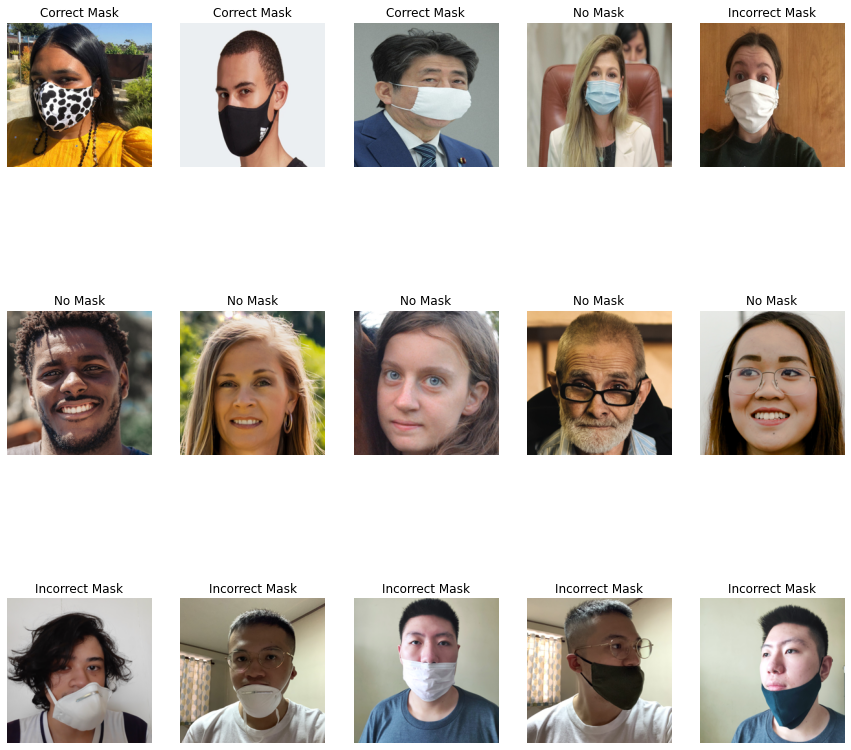

In [ ]:
plt.figure()
f, axarr = plt.subplots(3,5, figsize=(15,15))

plt.axis('off')

for i in range(3):
  for j in range(5):
    axarr[i][j].imshow(test_img[i*5 + j])
    axarr[i][j].set_title(test_pred[i*5 + j])
    axarr[i][j].axis('off')